# analisis estadístico de regresión lineal

In [280]:
#importamos librerias
import pandas as pd
import numpy as np
import seaborn as sns
import statsmodels.formula.api as sm

import matplotlib.pyplot as plt


In [281]:
#Cargamos base de datos
ds=pd.read_csv("kc_house_data.csv")
ds.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
5,7237550310,20140512T000000,1225000.0,4,4.50,5420,101930,1.0,0,0,...,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930
6,1321400060,20140627T000000,257500.0,3,2.25,1715,6819,2.0,0,0,...,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819
7,2008000270,20150115T000000,291850.0,3,1.50,1060,9711,1.0,0,0,...,7,1060,0,1963,0,98198,47.4095,-122.315,1650,9711
8,2414600126,20150415T000000,229500.0,3,1.00,1780,7470,1.0,0,0,...,7,1050,730,1960,0,98146,47.5123,-122.337,1780,8113
9,3793500160,20150312T000000,323000.0,3,2.50,1890,6560,2.0,0,0,...,7,1890,0,2003,0,98038,47.3684,-122.031,2390,7570


### Exploración y limpieza de datos

In [282]:
#reviso la cantidad de datos que tengo
observaciones,caracteristicas=ds.shape
print('observaciones(filas):',observaciones)
print('caracteristicas(columnas):',caracteristicas)

observaciones(filas): 21613
caracteristicas(columnas): 21


In [283]:
#Tipos de datos que tengo
ds.dtypes

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

In [284]:
#cantidad de valores unicos por caracteristica
ds.nunique(axis=0)

id               21436
date               372
price             4028
bedrooms            13
bathrooms           30
sqft_living       1038
sqft_lot          9782
floors               6
waterfront           2
view                 5
condition            5
grade               12
sqft_above         946
sqft_basement      306
yr_built           116
yr_renovated        70
zipcode             70
lat               5034
long               752
sqft_living15      777
sqft_lot15        8689
dtype: int64

In [285]:
#Generamos copia del original
df=ds.copy()

Se utilizara el Id como la base para hacer el analisis de este datasetpor lo tanto se elimina la columna de tiempo(date)

In [286]:
#eliminacion de la raviable tiempo
df.drop("date",inplace=True,axis=1)
df.shape

(21613, 20)

Evaluo cuantos datos por id existen

In [287]:
df['id'].value_counts(ascending=True)

1777500160    1
3021059276    1
4364700875    1
7812801125    1
3420069065    1
             ..
1995200200    2
3333002450    2
643300040     2
2206700215    2
795000620     3
Name: id, Length: 21436, dtype: int64

Se puede ver que exiten varios id con varios datos lo que puede significar reventa de la propieda o errores en la base de datos. Para este caso utilizaremos solo el primer dato que tengamos de esa propiedad.

In [288]:

df=df.groupby("id",as_index=False).first()

observaciones1,caracteristicas1=df.shape
print('observaciones(filas):',observaciones1)
print('caracteristicas(columnas):',caracteristicas1)

observaciones(filas): 21436
caracteristicas(columnas): 20


In [289]:
#Verificamos si hay datos nulos
df.isna().sum()

id               0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [290]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.143600e+04,2.143600e+04,21436.000000,21436.000000,21436.000000,2.143600e+04,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000,21436.000000
mean,4.580765e+09,5.405293e+05,3.371571,2.117349,2082.704936,1.513564e+04,1.496198,0.007604,0.235118,3.410384,7.661737,1790.960440,291.744495,1971.098433,84.729800,98077.862288,47.560156,-122.213697,1988.314378,12785.961280
std,2.876590e+09,3.676893e+05,0.929205,0.769913,919.146469,4.153862e+04,0.540388,0.086871,0.767092,0.650235,1.174256,829.026491,442.781983,29.385277,402.431012,53.469371,0.138601,0.140896,685.699093,27375.467469
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123700e+09,3.221500e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1200.000000,0.000000,1952.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000
50%,3.904921e+09,4.500000e+05,3.000000,2.250000,1920.000000,7.614000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.572000,-122.230000,1840.000000,7620.000000
75%,7.308675e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.069625e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2220.000000,560.000000,1997.000000,0.000000,98117.000000,47.678000,-122.124000,2370.000000,10087.250000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [291]:
df.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,1000102,280000.0,6,3.00,2400,9373,2.0,0,0,3,7,2400,0,1991,0,98002,47.3262,-122.214,2060,7316
1,1200019,647500.0,4,1.75,2060,26036,1.0,0,0,4,8,1160,900,1947,0,98166,47.4444,-122.351,2590,21891
2,1200021,400000.0,3,1.00,1460,43000,1.0,0,0,3,7,1460,0,1952,0,98166,47.4434,-122.347,2250,20023
3,2800031,235000.0,3,1.00,1430,7599,1.5,0,0,4,6,1010,420,1930,0,98168,47.4783,-122.265,1290,10320
4,3600057,402500.0,4,2.00,1650,3504,1.0,0,0,3,7,760,890,1951,2013,98144,47.5803,-122.294,1480,3504


In [292]:
#agregamos una nueva columna que nos indique hace cuanto fue renovada
df["yr_since_last_renovation"]=np.where(df['yr_renovated']>0,2015-df['yr_renovated'],0)


df.head(10)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_since_last_renovation
0,1000102,280000.0,6,3.00,2400,9373,2.0,0,0,3,...,2400,0,1991,0,98002,47.3262,-122.214,2060,7316,0
1,1200019,647500.0,4,1.75,2060,26036,1.0,0,0,4,...,1160,900,1947,0,98166,47.4444,-122.351,2590,21891,0
2,1200021,400000.0,3,1.00,1460,43000,1.0,0,0,3,...,1460,0,1952,0,98166,47.4434,-122.347,2250,20023,0
3,2800031,235000.0,3,1.00,1430,7599,1.5,0,0,4,...,1010,420,1930,0,98168,47.4783,-122.265,1290,10320,0
4,3600057,402500.0,4,2.00,1650,3504,1.0,0,0,3,...,760,890,1951,2013,98144,47.5803,-122.294,1480,3504,2
5,3600072,680000.0,4,2.75,2220,5310,1.0,0,0,5,...,1170,1050,1951,0,98144,47.5801,-122.294,1540,4200,0
6,3800008,178000.0,5,1.50,1990,18200,1.0,0,0,3,...,1990,0,1960,0,98178,47.4938,-122.262,1860,8658,0
7,5200087,487000.0,4,2.50,2540,5001,2.0,0,0,3,...,2540,0,2005,0,98108,47.5423,-122.302,2360,6834,0
8,6200017,281000.0,3,1.00,1340,21336,1.5,0,0,4,...,1340,0,1945,0,98032,47.4023,-122.273,1340,37703,0
9,7200080,239000.0,4,2.00,1980,10585,1.5,0,0,2,...,1980,0,1924,0,98055,47.4836,-122.214,1360,7810,0


In [293]:
#Variable baño podría tener unos outlayers en las propiedades que no tienen baños
df['bathrooms'].value_counts()

2.50    5355
1.00    3795
1.75    3020
2.25    2031
2.00    1913
1.50    1430
2.75    1182
3.00     747
3.50     729
3.25     586
3.75     155
4.00     134
4.50      99
4.25      79
0.75      71
4.75      23
5.00      21
5.25      13
0.00      10
5.50      10
1.25       9
6.00       6
5.75       4
0.50       4
6.25       2
6.75       2
6.50       2
8.00       2
7.50       1
7.75       1
Name: bathrooms, dtype: int64

count    21436.000000
mean         2.117349
std          0.769913
min          0.000000
25%          1.750000
50%          2.250000
75%          2.500000
max          8.000000
Name: bathrooms, dtype: float64
0    2.5
dtype: float64


C:\Users\Admin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


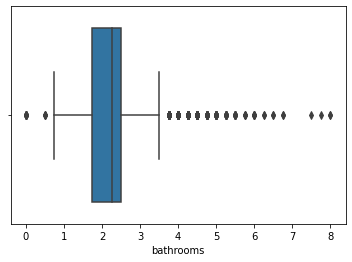

In [294]:
#identificacion grafica de out layers baños
sns.boxplot(df['bathrooms']);
print(df['bathrooms'].describe());
print(df['bathrooms'].mode())


Outlayers de cero baños se cambiaron por la moda 2.5

In [295]:
df['bathrooms'].where(df['bathrooms']>0,df['bathrooms'].mode(),inplace=True)
df['bathrooms'].value_counts()

2.50    5355
1.00    3795
1.75    3020
2.25    2031
2.00    1913
1.50    1430
2.75    1182
3.00     747
3.50     729
3.25     586
3.75     155
4.00     134
4.50      99
4.25      79
0.75      71
4.75      23
5.00      21
5.25      13
5.50      10
1.25       9
6.00       6
5.75       4
0.50       4
8.00       2
6.25       2
6.75       2
6.50       2
7.50       1
7.75       1
Name: bathrooms, dtype: int64

count    21436.000000
mean         3.371571
std          0.929205
min          0.000000
25%          3.000000
50%          3.000000
75%          4.000000
max         33.000000
Name: bedrooms, dtype: float64
moda: 0    3
dtype: int64


C:\Users\Admin\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


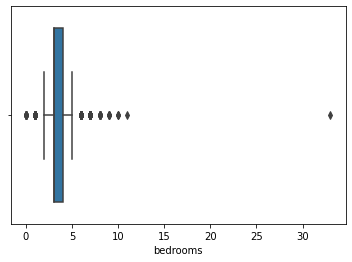

In [296]:
# identificacion Bedrooms outlayers 
"""no tiene sentido tener casa con 0 habitaciones y hay que revisar el tema de outlayers"""
print(df['bedrooms'].describe())
sns.boxplot(df['bedrooms']);
print('moda:',df['bedrooms'].mode())

In [297]:
"""cantidad de datos por encima del outlayer (10)"""

suma=0
for i in range(len(df['bedrooms'])):
  if df['bedrooms'][i]>10:
    suma=suma+1
  
suma
print("porcentaje de outlayer por encima de 10 habitaciones es: ",round((suma/df['bedrooms'].shape[0])*100,2),'%')

porcentaje de outlayer por encima de 10 habitaciones es:  0.01 %


Tratamiento de outlayer de las habitaciones, se decide que los valores con cero habitaciones se les aplicara la moda y se descartaran los outlayers mayores a 10 baños que son el 0.01 % del total de los datos

In [298]:
df.drop(df.loc[df['bedrooms']>10].index, inplace=True)
df['bedrooms'].where(df['bedrooms']>0,df['bedrooms'].mode(),inplace=True)
df['bedrooms'].describe()

count    21421.000000
mean         3.371878
std          0.901902
min          1.000000
25%          3.000000
50%          3.000000
75%          4.000000
max         10.000000
Name: bedrooms, dtype: float64

In [299]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_since_last_renovation
count,2.143400e+04,2.143400e+04,21421.000000,21424.000000,21434.000000,2.143400e+04,21434.000000,21434.000000,21434.000000,21434.000000,...,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000,21434.000000
mean,4.580998e+09,5.405256e+05,3.371878,2.118314,2082.683727,1.513654e+04,1.496198,0.007605,0.235140,3.410329,...,1790.967062,291.716665,1971.102034,84.644443,98077.859802,47.560151,-122.213685,1988.371606,12786.703648,0.810208
std,2.876621e+09,3.677058e+05,0.901902,0.768740,919.162563,4.154045e+04,0.540392,0.086875,0.767125,0.650169,...,829.038864,442.793257,29.383948,402.236893,53.471244,0.138605,0.140897,685.705351,27376.636784,5.001189
min,1.000102e+06,7.500000e+04,1.000000,0.500000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,...,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,0.000000
25%,2.123787e+09,3.220500e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,...,1200.000000,0.000000,1952.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000,0.000000
50%,3.904926e+09,4.500000e+05,3.000000,2.250000,1920.000000,7.614500e+03,1.500000,0.000000,0.000000,3.000000,...,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.572000,-122.230000,1840.000000,7620.000000,0.000000
75%,7.308825e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.069675e+04,2.000000,0.000000,0.000000,4.000000,...,2220.000000,560.000000,1997.000000,0.000000,98117.000000,47.678000,-122.124000,2370.000000,10087.750000,0.000000
max,9.900000e+09,7.700000e+06,10.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,...,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,81.000000


Distribución de variables numericas

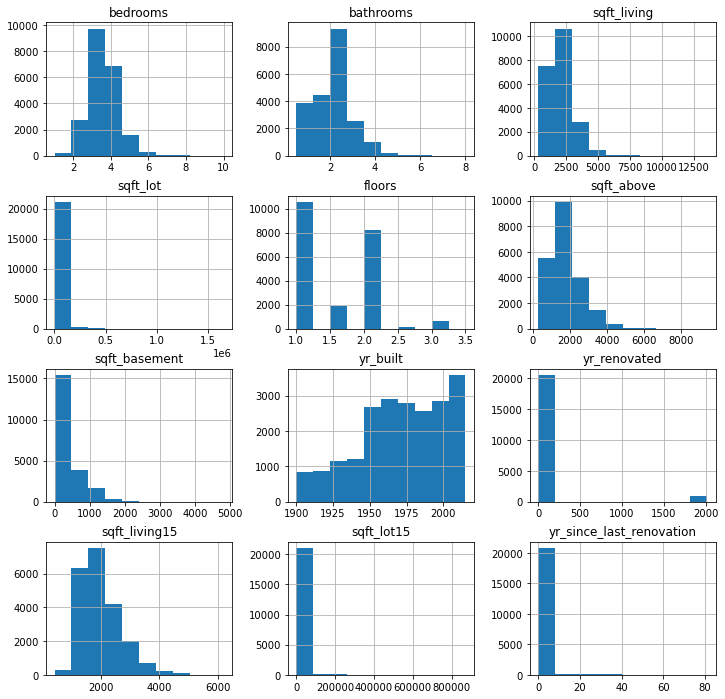

In [300]:
df.hist(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors','sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated','sqft_living15', 'sqft_lot15', 'yr_since_last_renovation'],figsize=(12,12),xlabelsize=10,ylabelsize=10);

distribución de variables categoricas

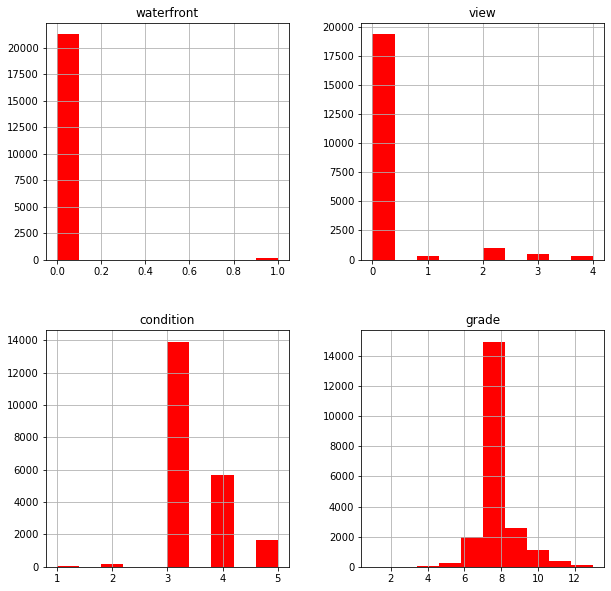

In [301]:
categoricas=df[['waterfront', 'view', 'condition', 'grade']]
categoricas.hist(ylabelsize=10,xlabelsize=10,figsize=(10,10),color=['red']);

### Tabla de contingencia para variables categoricas

Tabla de contingecia para evaluar relación entre variables categoricas

In [302]:
pd.crosstab([categoricas.waterfront,categoricas.grade],categoricas.view,margins=True,margins_name="Total")


view                  0    1    2    3    4  Total
waterfront grade                                  
0          1          1    0    0    0    0      1
           3          3    0    0    0    0      3
           4         26    2    1    0    0     29
           5        221    2    6    0    1    230
           6       1912   15   40   12    4   1983
           7       8470   93  220   76   12   8871
           8       5391  109  325  141   38   6004
           9       2151   63  188  124   55   2581
           10       855   26  100   81   40   1102
           11       240   18   58   43   17    376
           12        43    2   13    9   11     78
           13         5    0    3    2    3     13
1          5          0    0    0    1    3      4
           6          0    0    2    2    8     12
           7          0    1    1    2   19     23
           8          0    0    1    4   35     40
           9          0    0    1    6   18     25
           10         0    0    2    3   23     28
           11         0    0    1    1   18     20
           12         0    0    0    0   11     11
Total             19318  331  962  507  316  21434

### correlaciones

Correlación entre la variable objetivo y las otras caracteristicas

In [303]:
corr_new1=df.corrwith(df['price']).sort_values(ascending=False)
corr_new1


price                       1.000000
sqft_living                 0.702024
grade                       0.667513
sqft_above                  0.605529
sqft_living15               0.584721
bathrooms                   0.526237
view                        0.396939
sqft_basement               0.323554
bedrooms                    0.317369
lat                         0.306052
waterfront                  0.266963
floors                      0.256303
yr_renovated                0.127084
sqft_lot                    0.088897
sqft_lot15                  0.082042
yr_since_last_renovation    0.070235
yr_built                    0.052978
condition                   0.035062
long                        0.020580
id                         -0.018508
zipcode                    -0.052176
dtype: float64

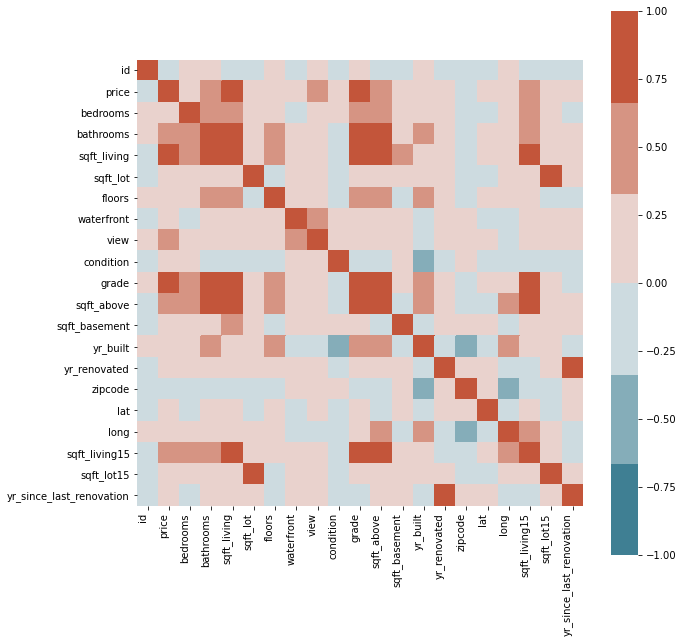

In [304]:
#Correlaciones graficas de todas la variables
fig, ax = plt.subplots(figsize=(10,10)) 

corr_new=df.corr()

ax = sns.heatmap(
    corr_new,ax=ax, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(220, 20),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=90,
    horizontalalignment='right'
);




Distribución de las caracteristicas con mayor correlación y la variable objetivo para identificar posibles relaciones lineales

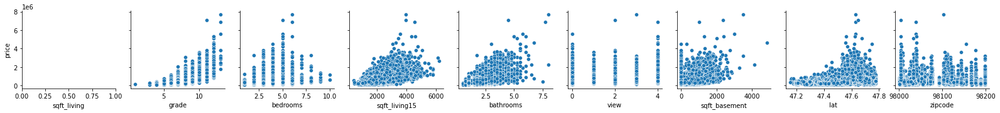

In [305]:
sns.pairplot(df,y_vars='price',x_vars=['sqft_living','grade','bedrooms','sqft_living15','bathrooms','view','sqft_basement','lat','zipcode']);

El lugar donde queda la vivienda es una caracteristica muy importante para determianr el precio, por esto es importante utilizar las variables de localización geografica como: latitud,longitud y codigo postal

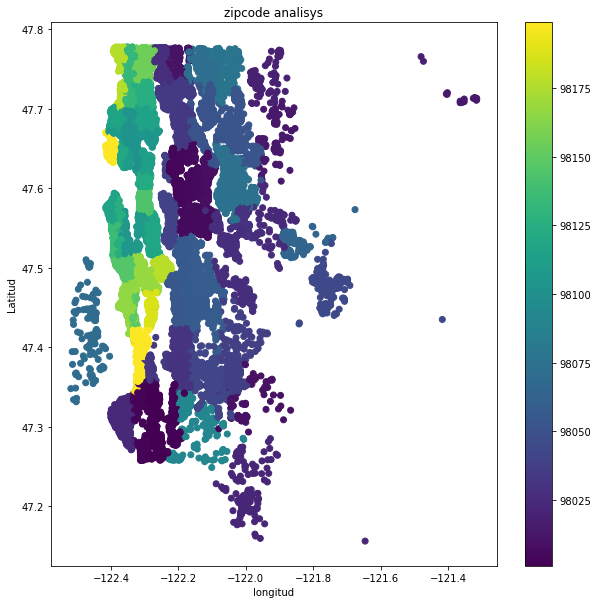

In [306]:
#Relación entre la latitud, la longitud y el zipcode de forma grafica
plt.figure(figsize=(10,10))
plt.scatter(df['long'],df['lat'],c=df['zipcode'])
plt.colorbar()
plt.title('zipcode analisys')
plt.xlabel('longitud');
plt.ylabel('Latitud');



Grafico 3d para tratar de encontrar alguna relación entre la localizacion geografica y el costo de las vivienda, se puede apreciar que hay algunos lugaraes donde claramente el precio aumenta.

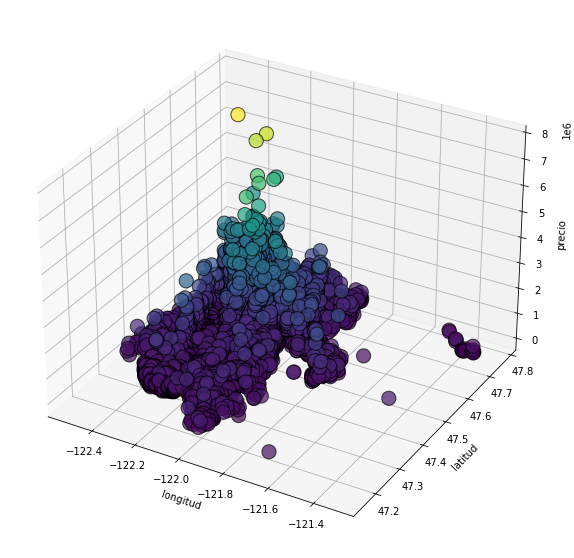

In [307]:
fig=plt.figure(figsize=(10,10),)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df['long'],df['lat'],df['price'],linewidths=1, alpha=.7,
           edgecolor='k',
           s = 200,
           c=df['price'])
plt.xlabel("longitud");
plt.ylabel('latitud');
ax.set_zlabel('precio');

plt.show()



Se formaron 2 dataset nuevos basados en el costo de la vivienda, el primero son viviendas con precios mayores al promedio 320000 y el segundo menores a este precio. Estos dataset se incluyeron las variables:lat,long,price,zipcode

In [308]:
new_dataset=df.loc[df['price']>320000,['lat','long','price','zipcode']]
new_dataset.shape

(16103, 4)

Se decidio crear un mapa de la zona donde nos mostrata la identificacón de estos lugares para tratar de entender cual es la zona que hace que aumente el precio de las viviendas

In [309]:
import folium
mmap=folium.Map(location=[47.625193,-122.364342],zoom_start=10
                                  , tiles="OpenStreetMap")

seattle=folium.map.FeatureGroup()


In [310]:
latitud=list(new_dataset['lat'].values)
longitud=list(new_dataset['long'].values)


In [311]:

"""Viviendas de menos de mas de 320000  dolares"""
for i in range(len(latitud)):    
    folium.RegularPolygonMarker([latitud[i],longitud[i]],
                color="green",fill_color="green",radius=7).add_to(seattle)
                     
mmap.add_child(seattle)

In [312]:
#dataset de viviendas de menos de 320000
new_dataset2=df.loc[df['price']<320000,['lat','long','price','zipcode']]
new_dataset2.shape

(5224, 4)

In [313]:

latitud2=list(new_dataset2['lat'].values)
longitud2=list(new_dataset2['long'].values)
#Mapa de viviendas de mas de 320000 dolares(verdes) y de menos de 320000(rojas)
for i in range(len(latitud2)):    
    folium.RegularPolygonMarker([latitud2[i],longitud2[i]],
                color="red",fill_color="red",radius=7).add_to(seattle)
                     
mmap.add_child(seattle)

<b>Se asume que a menor es la distancia de Bellevue o seattle mayor será el precio de la vivienda</b>

In [314]:
#paquete que me sirve para medir distancias geograficas con las latitud y longitud(haversine)
from haversine import haversine, Unit
#seattle center
seattle_coor=(47.625193,-122.364342)
belleveu_coor=(47.607090,-122.197557)
#valores de distancia
lat=list(df['lat'].values)
long=list(df['long'].values)
#uno los valores de distacia 
coordinate=list(zip(lat,long))
dis_from_center=[]
for i in coordinate:
    dist_seattle=haversine(seattle_coor,i)
    dist_belleveu=haversine(belleveu_coor,i)
    dis_from_center.append(min(dist_seattle,dist_belleveu))

df['Distancia_centro']=dis_from_center



In [315]:
df.head()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_since_last_renovation,Distancia_centro
0,1000102,280000.0,6.0,3.00,2400,9373,2.0,0,0,3,...,0,1991,0,98002,47.3262,-122.214,2060,7316,0,31.258033
1,1200019,647500.0,4.0,1.75,2060,26036,1.0,0,0,4,...,900,1947,0,98166,47.4444,-122.351,2590,21891,0,20.128229
2,1200021,400000.0,3.0,1.00,1460,43000,1.0,0,0,3,...,0,1952,0,98166,47.4434,-122.347,2250,20023,0,20.256369
3,2800031,235000.0,3.0,1.00,1430,7599,1.5,0,0,4,...,420,1930,0,98168,47.4783,-122.265,1290,10320,0,15.189242
4,3600057,402500.0,4.0,2.00,1650,3504,1.0,0,0,3,...,890,1951,2013,98144,47.5803,-122.294,1480,3504,2,7.261744


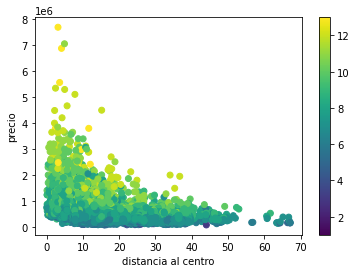

In [316]:
"""apartamentos mas cercanos al centro y su condicón actualmente
se puede ver que mientras mas cercanos al centro su condicón mejora"""

plt.scatter(df['Distancia_centro'],df['price'],c=df['grade']);
plt.xlabel('distancia al centro');
plt.ylabel('precio');
plt.colorbar();


## modelos

Se empeizan a probar modelos, primero utilizando una sola variable y las que muestran mayor linealidad con la variable objetivo

In [317]:
#Model 1

model1 = sm.ols(formula='price ~ sqft_living ', data=df).fit()
model1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.493
Method:                 Least Squares   F-statistic:                 2.083e+04
Date:                Sun, 08 Aug 2021   Prob (F-statistic):               0.00
Time:                        18:44:42   Log-Likelihood:            -2.9781e+05
No. Observations:               21434   AIC:                         5.956e+05
Df Residuals:                   21432   BIC:                         5.956e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept   -4.438e+04   4430.120    -10.017      0.000   -5.31e+04   -3.57e+04
sqft_living   280.8407      1.946    144.314      0.000     277.026     284.655
==============================================================================
Omnibus:                    14716.472   Durbin-Watson:                   1.044
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           542111.725
Skew:                           2.826   Prob(JB):                         0.00
Kurtosis:                      26.981   Cond. No.                     5.64e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.64e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [318]:
#Revisión de linealidad
import statsmodels.stats.api as sms
sms.linear_harvey_collier(model1)
#"""H0=mi modelo esta completamente lineal
#H1=mi modelo no es lineal"""

#NO se rechaza la hipotesis nula
#p-value < 0.05 <- Hipotesis Nula es Falsa
#p-value > 0.05 <- Hipotesis Nula es Verdadera ó No hay evidencia estadistica para rechazar la hipotesis Nula

Ttest_1sampResult(statistic=-0.5497610450659394, pvalue=0.5824890097284882)

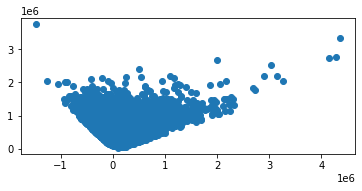

In [319]:
"si esto tuviera una tendencia me estaria indicando que no es lineal"
#Forma de revisar linealidad graficamente
pred_val = model1.fittedvalues.copy()
true_val = df['price'].values.copy()
residual = true_val - pred_val
fig, ax = plt.subplots(figsize=(6,2.5))
ax.scatter(residual, pred_val);

In [320]:
#modelo 2
model2 = sm.ols(formula='price ~  sqft_above', data=df).fit()

#modelo es lineal

In [321]:
#modelo 3 con variable cotegorica
model3 = sm.ols(formula='price ~ + grade ', data=df).fit()
print(sms.linear_harvey_collier(model3))
print('r cuadrado',model3.rsquared)
#El r cuadrado es bueno pero no cumple que sea un modelo lineal

Ttest_1sampResult(statistic=-3.1893337820213885, pvalue=0.0014280627119383142)
r cuadrado 0.4455734824611641


In [322]:
#Modelo 4 donde se empieza a mezclar las caracteristicas con mejores modelos
model4= sm.ols(formula='price ~ sqft_living + grade  + Distancia_centro ', data=df).fit()
print(model4.summary())
print(" ")
print(sms.linear_harvey_collier(model4))

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.651
Model:                            OLS   Adj. R-squared:                  0.651
Method:                 Least Squares   F-statistic:                 1.331e+04
Date:                Sun, 08 Aug 2021   Prob (F-statistic):               0.00
Time:                        18:44:43   Log-Likelihood:            -2.9381e+05
No. Observations:               21434   AIC:                         5.876e+05
Df Residuals:                   21430   BIC:                         5.877e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept        -2.666e+05   1.23e+04  

Este modelo es el mejor que se ha implementado hasta el momento con un r cuadrado de 0.651 y superando la prueba de linealidad

In [323]:
# modelo probando variables categoricas

model5= sm.ols(formula='price ~ sqft_living + grade  + Distancia_centro  + view', data=df).fit()
print(model5.summary())


                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.683
Model:                            OLS   Adj. R-squared:                  0.683
Method:                 Least Squares   F-statistic:                 1.154e+04
Date:                Sun, 08 Aug 2021   Prob (F-statistic):               0.00
Time:                        18:44:44   Log-Likelihood:            -2.9278e+05
No. Observations:               21434   AIC:                         5.856e+05
Df Residuals:                   21429   BIC:                         5.856e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept        -2.256e+05   1.17e+04  

Este es el mejor resultado que se tiene, hay que tener encuenta que la variable zipcode nos podría ayudar a mejorarlo pero aun no se como manejarla bien.

**¿La variable objetivo esta distribuido normalmente?**

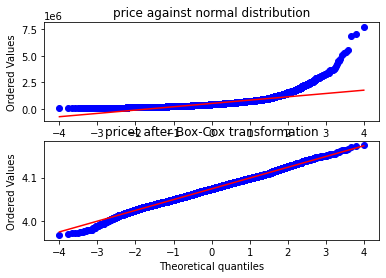

In [324]:
from scipy import stats
# scipy.stats.boxcox()

fig = plt.figure()
ax1 = fig.add_subplot(211)
x = df['price']
prob = stats.probplot(x, dist=stats.norm, plot=ax1)
ax1.set_xlabel('')
ax1.set_title('price against normal distribution')
ax2 = fig.add_subplot(212)
xt, _ = stats.boxcox(x)
prob = stats.probplot(xt, dist=stats.norm, plot=ax2)
ax2.set_title('pricet after Box-Cox transformation')
plt.show()

Para usar un modelo lineal se recomienda que la variable objetivo sea lineal, de lo contrario se recomienda usar un modelo lineal generalizado.... para nuestro caso decidimos hacer una tranformación boxcox a nuestra variable *precio* y probarla en el modelo.

In [325]:
df['boxcox_priace']=xt


In [326]:
#modelo con variable objetivo tranformada

model6= sm.ols(formula='boxcox_priace ~ sqft_living + grade  + Distancia_centro  + view', data=df).fit()
print(model6.summary())


                            OLS Regression Results                            
Dep. Variable:          boxcox_priace   R-squared:                       0.741
Model:                            OLS   Adj. R-squared:                  0.741
Method:                 Least Squares   F-statistic:                 1.535e+04
Date:                Sun, 08 Aug 2021   Prob (F-statistic):               0.00
Time:                        18:44:44   Log-Likelihood:                 63457.
No. Observations:               21434   AIC:                        -1.269e+05
Df Residuals:                   21429   BIC:                        -1.269e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
Intercept            4.0181      0.001  

**Esta tranformación mostro un incremento positivo en el r score del modelo**

## MODELO DE MACHINE LEARNING

In [342]:
df_final=df[['boxcox_priace','sqft_living','grade','Distancia_centro','view']]
df_final.head()

,boxcox_priace,sqft_living,grade,Distancia_centro,view
0,4.050385,2400,7,31.258033,0
1,4.090975,2060,8,20.128229,0
2,4.068631,1460,7,20.256369,0
3,4.040850,1430,6,15.189242,0
4,4.068936,1650,7,7.261744,0


Como tengo variables con diferentes valores y como se demostro que solo normalizando la variable objetivo mi modelo mejora mucho se aplicara una normalización a todos los datos elegidos

In [328]:
# from sklearn.pipeline import Pipeline
# from sklearn.impute import SimpleImputer
# from sklearn.preprocessing import OneHotEncoder,StandardScaler
# from sklearn.compose import ColumnTransformer

In [329]:
# num_pipeline=Pipeline([('imputer',SimpleImputer(strategy='mean')),
#                        ('std_scaler',StandardScaler()),
#                       ])
# data_tranform=num_pipeline.fit_transform(df_final)
# data_tranform=pd.DataFrame(data_tranform)
# data_tranform.columns=df_final.columns


In [330]:
# data_tranform.head()

In [343]:
from sklearn import linear_model 
#modelo
lm=linear_model.LinearRegression()
from sklearn.model_selection import train_test_split
caracteristicas=df_final[['sqft_living','grade','Distancia_centro','view']].values
objetivo=df_final['boxcox_priace'].values
print(caracteristicas.shape)
print(objetivo.shape)
type(objetivo)

(21434, 4)
(21434,)


numpy.ndarray

In [344]:
#separación de entrenamiento
x_train,x_test,y_train,y_test=train_test_split(caracteristicas,objetivo,train_size=0.8,random_state=4)

In [345]:
lm.fit(x_train,y_train)
prediccion=x_test
#Hacemos la prediccion
resultado=lm.predict(prediccion)
resultado.shape

(4287,)

In [346]:
y_test.shape

(4287,)

In [347]:
#importamos nuestra funcion metrics
from sklearn import metrics
#Evaluamos que tan preciso es nuestro modelo
score_prediction=metrics.mean_squared_error(y_test,resultado)
#Vemos el resultado
score_prediction

0.00015147792362495003